In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [10]:
import warnings
warnings.filterwarnings('ignore')

In [2]:
from fastai import *
from fastai.vision import *
from fastai.callbacks import *

In [21]:
from helper.object_detection_helper import *
from loss.RetinaNetFocalLoss import RetinaNetFocalLoss
from models.RetinaNet import RetinaNet
from callbacks.callbacks import BBLossMetrics, BBMetrics, PascalVOCMetric

In [4]:
dots = Path('/data/Datasets/EIPH_WSI/RCNN-Patches/512/')

In [5]:
dots

PosixPath('/data/Datasets/EIPH_WSI/RCNN-Patches/512')

In [7]:
images, lbl_bbox = get_annotations(dots/'WIPH_WSI_Coco.json')
img2bbox = dict(zip(images, lbl_bbox))
get_y_func = lambda o:img2bbox[o.name]

### Size
- 256
- 512 
- 1024


In [17]:
size = 512
bs = 64

In [11]:
data = (ObjectItemList.from_folder(dots)
        #Where are the images? -> in coco
        .random_split_by_pct()
        #How to split in train/valid? -> randomly with the default 20% in valid
        .label_from_func(get_y_func)
        #How to find the labels? -> use get_y_func
        .transform(get_transforms(), tfm_y=True, size=size)
        #Data augmentation? -> Standard transforms with tfm_y=True
        .databunch(bs=bs, collate_fn=bb_pad_collate))
        #Finally we convert to a DataBunch and we use bb_pad_collate
#data = data.normalize()

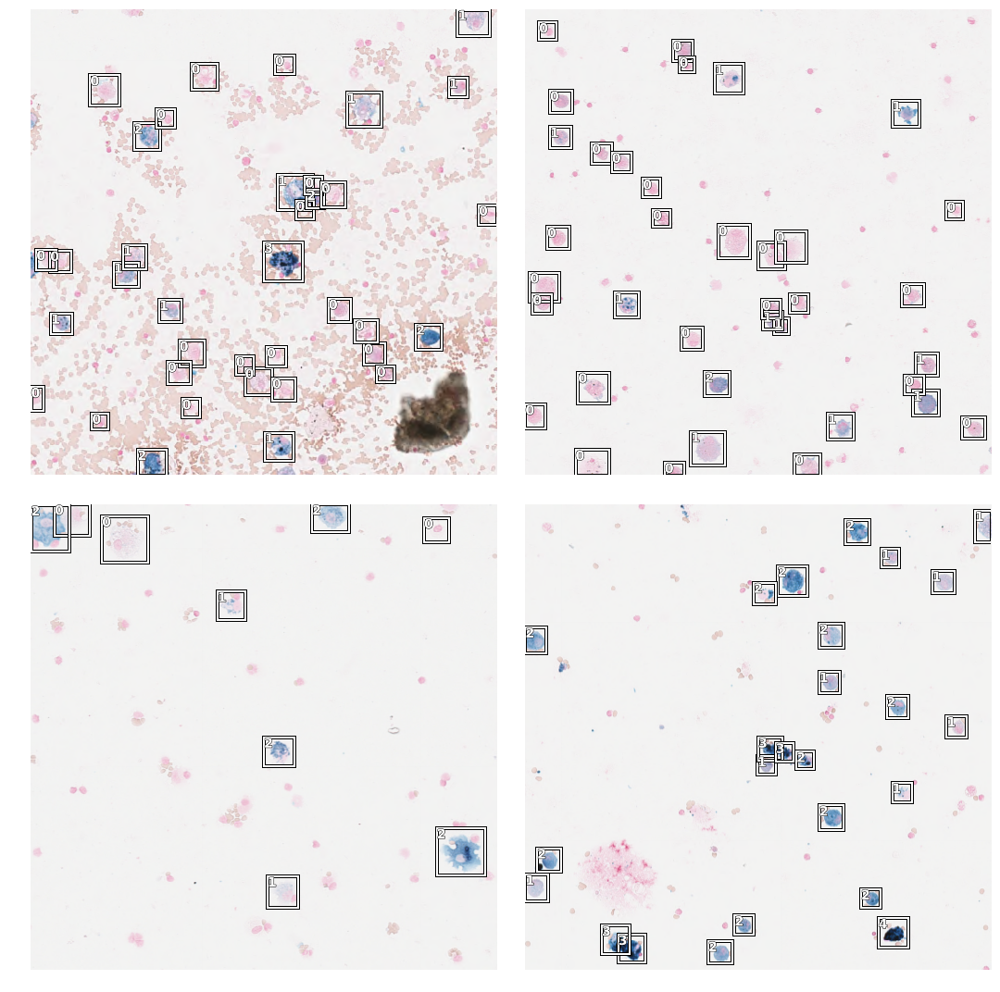

In [12]:
data.show_batch(rows=2, ds_type=DatasetType.Valid, figsize=(15,15))

### Create anchors and test them 

In [15]:
anchors = create_anchors(sizes=[(32,32)], ratios=[1], scales=[0.35, 0.5, 0.6])

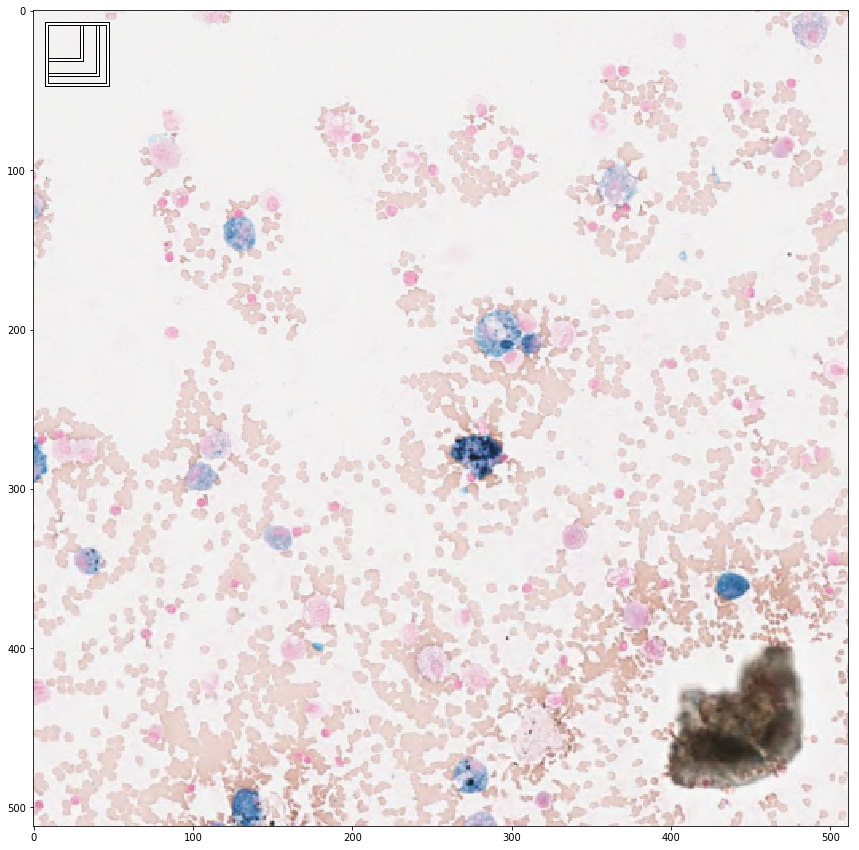

In [18]:
fig,ax = plt.subplots(figsize=(15,15))
ax.imshow(image2np(data.valid_ds[0][0].data))

for i, bbox in enumerate(anchors[:3]):
    bb = bbox.numpy()
    x = (bb[0] + 1) * size / 2 
    y = (bb[1] + 1) * size / 2 
    w = bb[2] * size / 2
    h = bb[3] * size / 2
    
    rect = [x,y,w,h]
    draw_rect(ax,rect)

## The objects on the left side are covered by anchors. On the right side ware objects that would be missed in training

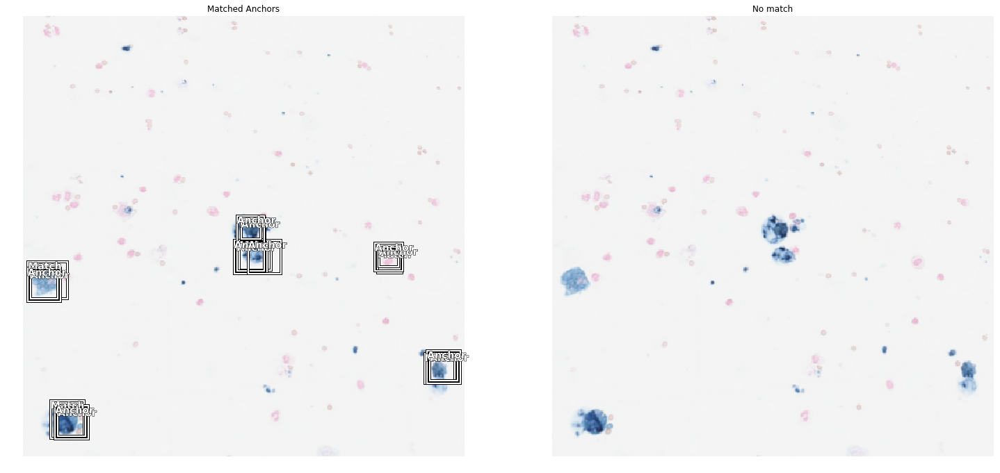

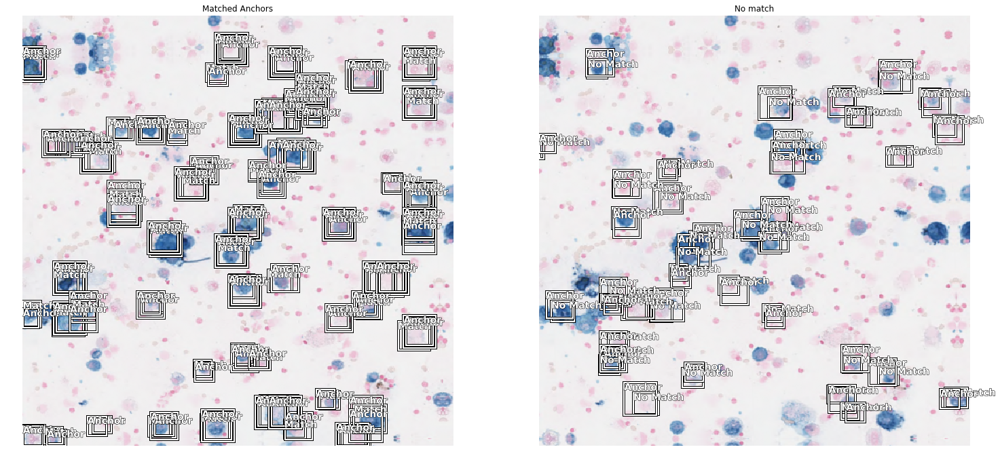

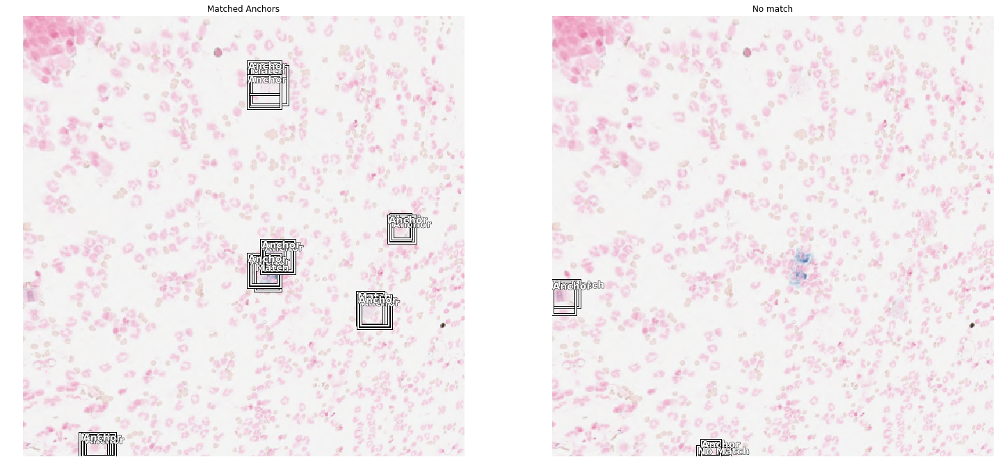

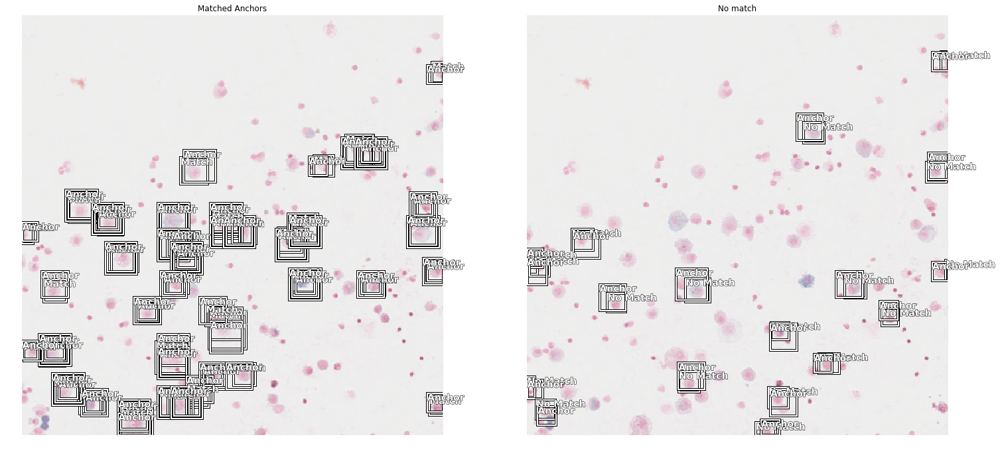

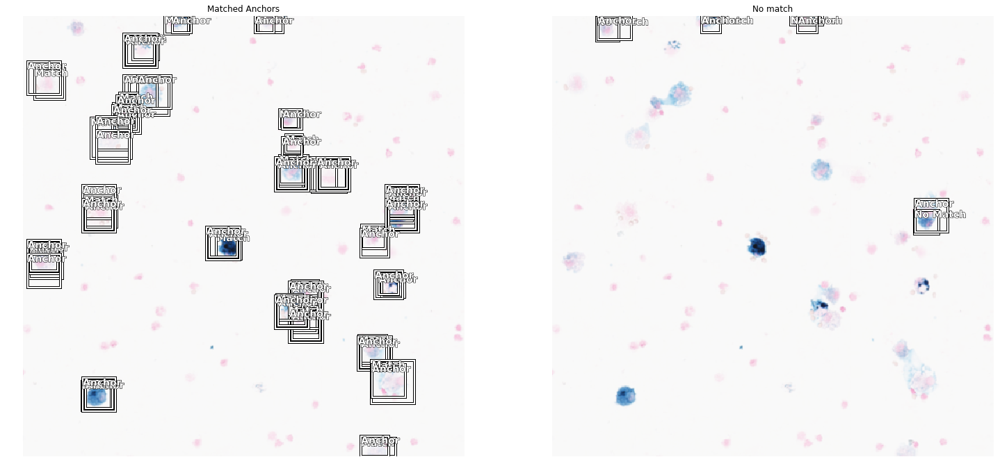

...

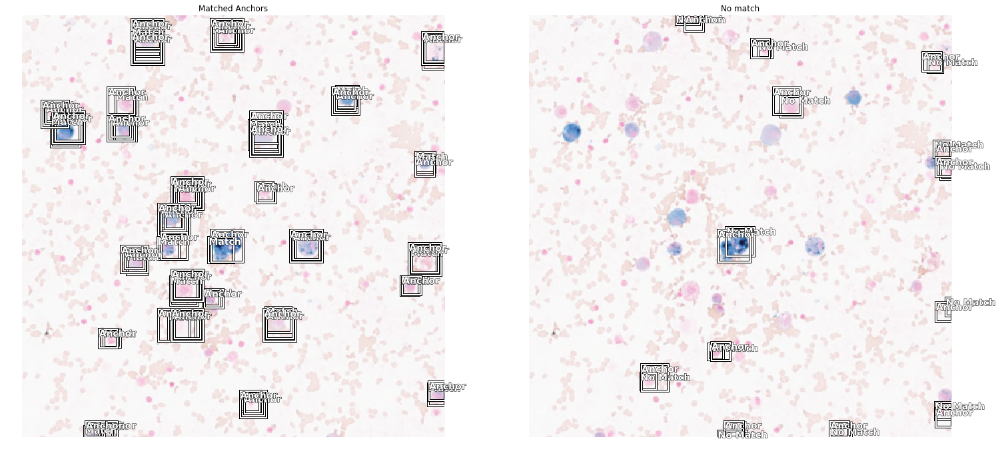

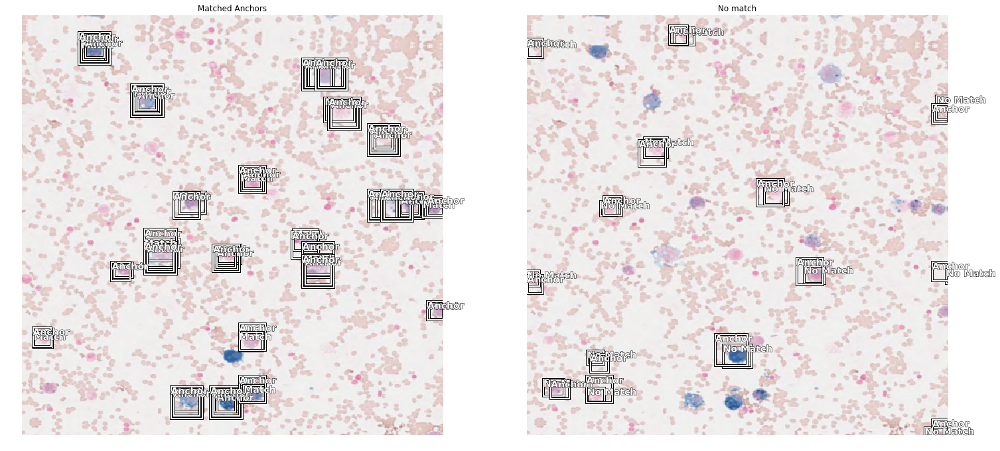

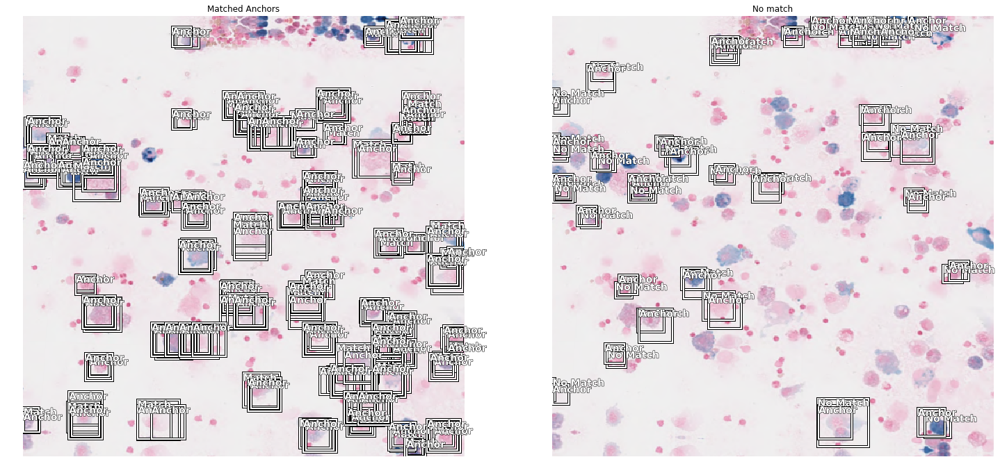

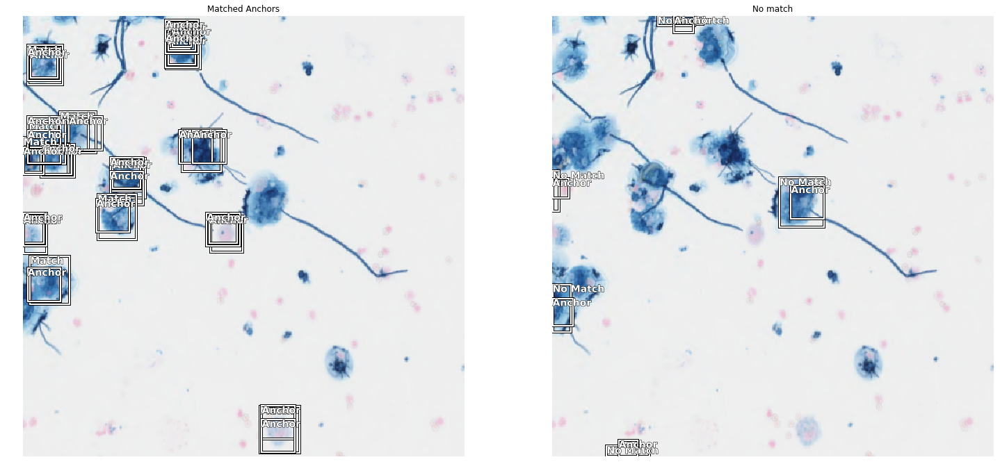

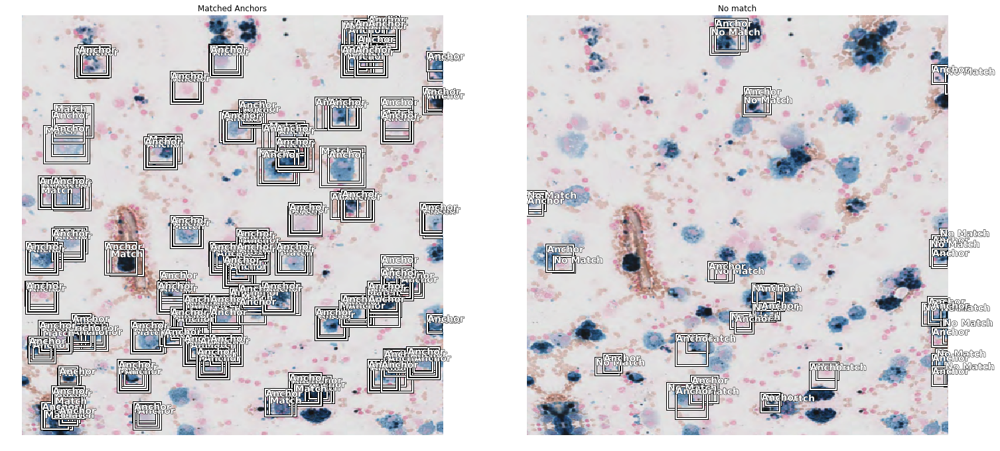

In [19]:
all_boxes, all_labels = show_anchors_on_images(data, anchors, figsize=(25,25))

## Model and Loss 

In [14]:
n_classes = data.train_ds.c

crit = RetinaNetFocalLoss(anchors)

encoder = create_body(models.resnet18, True, -2)
model = RetinaNet(encoder, n_classes=data.train_ds.c, n_anchors=3, sizes=[32], chs=32, final_bias=-4., n_conv=2)
model.eval()

RetinaNet(
  (encoder): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
       

In [23]:
voc = PascalVOCMetric(anchors, size, [i for i in data.train_ds.y.classes[1:]])
learn = Learner(data, model, loss_func=crit, callback_fns=[ShowGraph, BBMetrics],
                metrics=[voc])

In [24]:
learn.split([model.encoder[6], model.c5top5])
learn.freeze_to(-2)

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


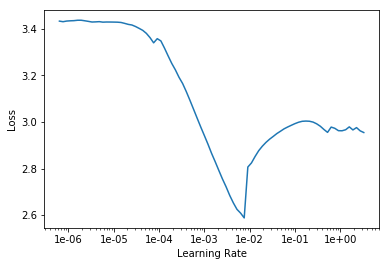

In [25]:
learn.lr_find()
learn.recorder.plot()

epoch,train_loss,valid_loss,pascal_voc_metric,BBloss,focal_loss,AP-0,AP-1,AP-2,AP-3,AP-4,time
0,3.184951,4.636493,0.014674,0.517234,4.119259,0.006418,0.020228,0.046726,0.000000,0.000000,00:44
1,2.795683,2.386909,0.015887,0.497974,1.888935,0.000000,0.007733,0.071616,0.000086,0.000000,00:24
2,2.452553,2.021140,0.022349,0.490847,1.530292,0.014171,0.033235,0.045451,0.018888,0.000000,00:31


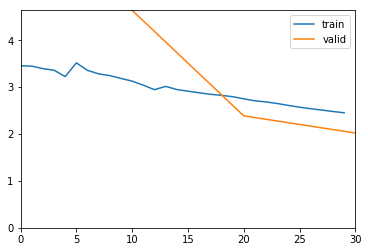

In [26]:
learn.fit_one_cycle(3, 1e-3)

epoch,train_loss,valid_loss,pascal_voc_metric,BBloss,focal_loss,AP-0,AP-1,AP-2,AP-3,AP-4,time
0,1.640627,1.683870,0.021687,0.481092,1.202778,0.002198,0.014906,0.084734,0.006595,0.000000,00:19
1,1.440018,1.523801,0.042913,0.406195,1.117606,0.002438,0.113164,0.075483,0.016437,0.007042,00:18
2,1.287667,1.195866,0.090012,0.358669,0.837196,0.136414,0.039799,0.127783,0.142544,0.003521,00:21
3,1.157167,0.900978,0.221940,0.321871,0.579107,0.301344,0.165730,0.247286,0.285833,0.109505,00:32
4,1.037224,0.792223,0.167577,0.241858,0.550365,0.325625,0.205856,0.151499,0.120199,0.034708,00:34
5,0.937141,0.706722,0.168670,0.220956,0.485766,0.323790,0.258036,0.132219,0.093462,0.035841,00:24
6,0.859649,0.633336,0.225837,0.240625,0.392710,0.432379,0.356338,0.082262,0.258208,0.000000,00:26
7,0.795982,0.603554,0.323176,0.193086,0.410468,0.469073,0.436425,0.219634,0.404547,0.086201,00:31
8,0.744512,0.526130,0.294215,0.182288,0.343842,0.498783,0.412184,0.188867,0.304081,0.067160,00:27
9,0.701477,0.515989,0.314604,0.179141,0.336848,0.503156,0.441515,0.221769,0.341760,0.064823,00:27


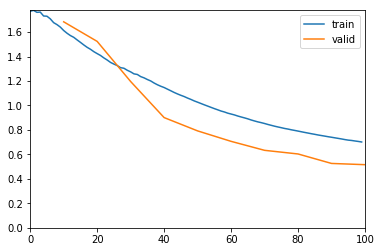

In [27]:
learn.unfreeze()
learn.fit_one_cycle(10, 1e-3)

In [46]:
data.train_ds.classes

['background', '0', '1', '2', '3', '4']

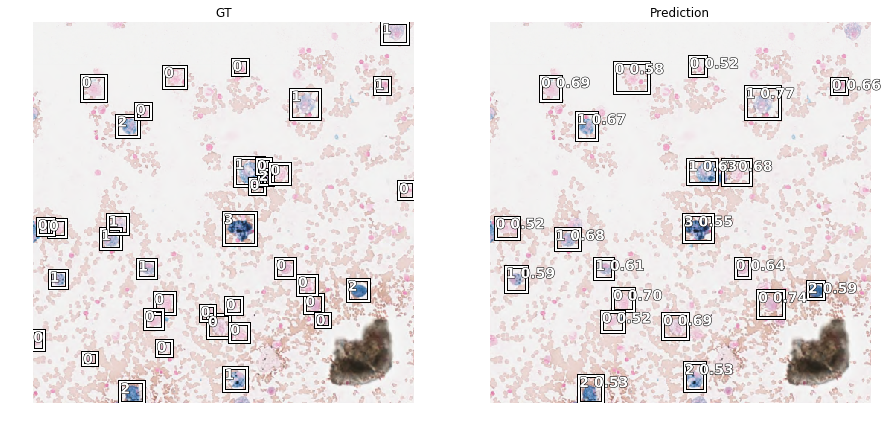

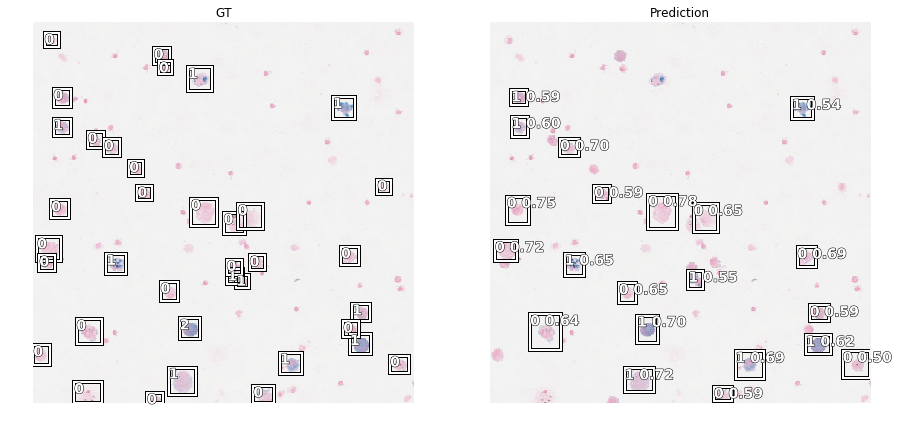

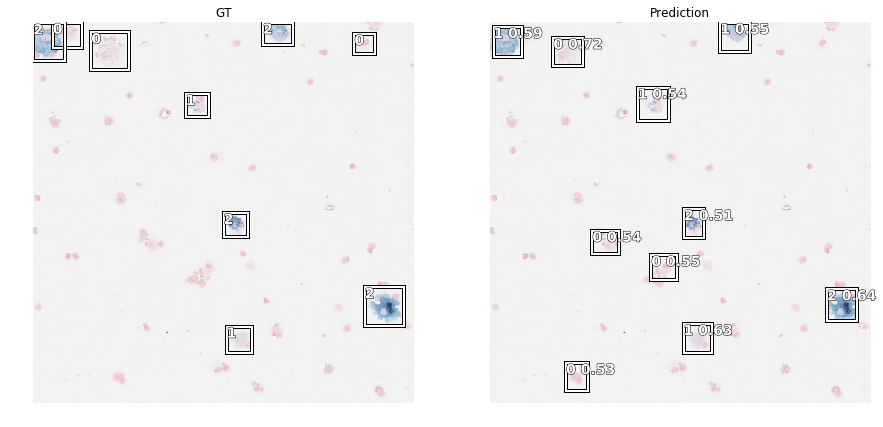

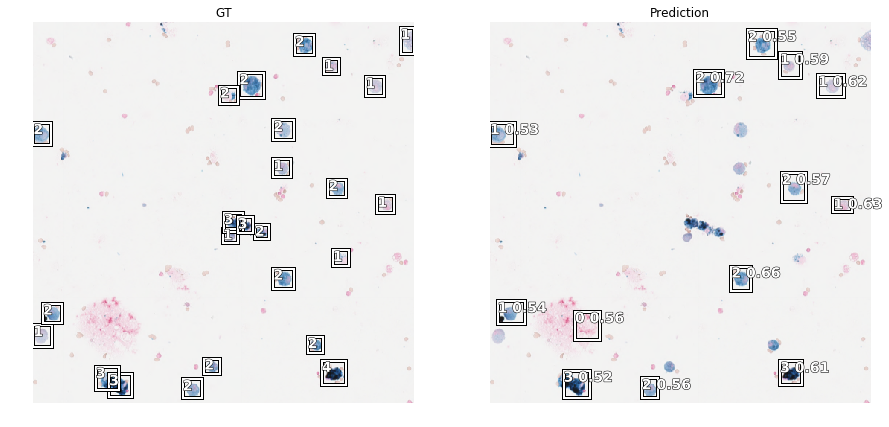

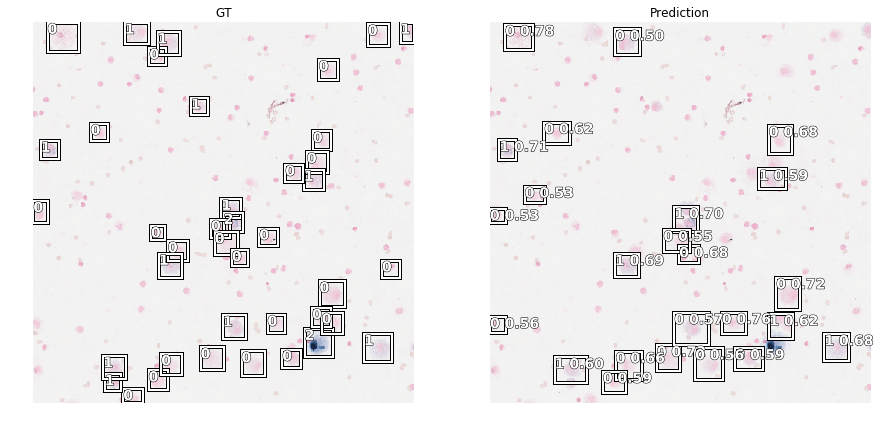

In [48]:
show_results_side_by_side(learn, anchors, detect_thresh=0.5, nms_thresh=0.1, image_count=5)